In [23]:
import os
from base64 import b64encode

import cv2
import lovely_numpy as ln
import matplotlib.pyplot as plt
import numpy as np
import supervision as sv
import torch
from cotracker.predictor import CoTrackerPredictor
from cotracker.utils.visualizer import Visualizer, read_video_from_path
from IPython.display import HTML
from roboflow import Roboflow

rf = Roboflow(api_key="nVeBbpBLolxpTnnaEMTT")

In [2]:
video_file_path = "/home/017534556/projects/cmpe_297/object_tracker/test_2.mp4"

In [3]:
video = read_video_from_path(video_file_path)
image = video[0].copy()
video = torch.from_numpy(video).permute(0, 3, 1, 2)[None].float()

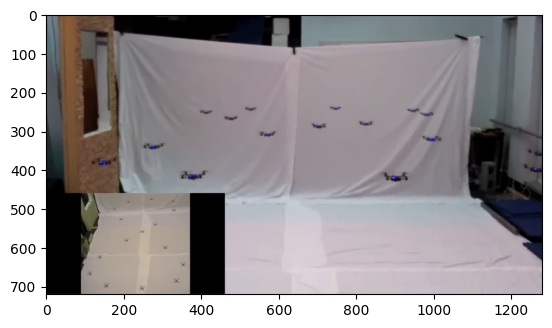

In [4]:
plt.imshow(image)

In [5]:
def show_video(video_path):
    video_file = open(video_path, "r+b").read()
    video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"
    return HTML(
        f"""<video width="640" height="480" autoplay loop controls><source src="{video_url}"></video>"""
    )


show_video(video_file_path)

In [8]:


model = CoTrackerPredictor(
    checkpoint=os.path.join(
        "/home/017534556/projects/cmpe_297/object_tracker/co-tracker/notebooks/checkpoints/cotracker2.pth"
    )
)

In [9]:
if torch.cuda.is_available():
    model = model.cuda()
    video = video.cuda()

In [10]:
project = rf.workspace().project("yolov8_detfly-02")
rb_model = project.version(1).model

loading Roboflow workspace...
loading Roboflow project...


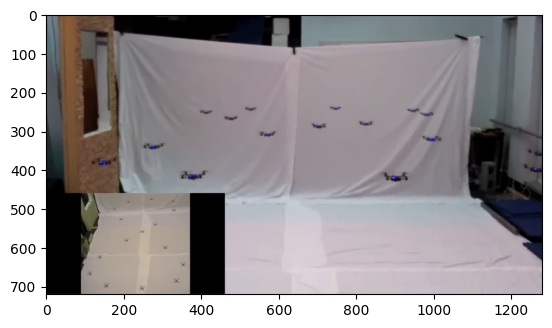

In [11]:
plt.imshow(image)

overflow encountered in scalar negative


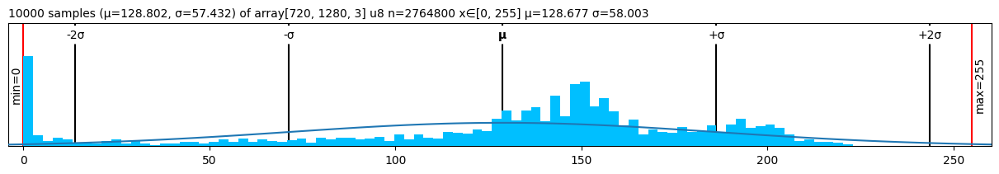

In [22]:
ln.plot(image)

In [12]:
results = rb_model.predict(image, confidence=50, overlap=30).json()

In [13]:
detections = sv.Detections.from_inference(results)

In [14]:
detections

Detections(xyxy=array([[ 729.,  235.,  764.,  248.],
       [ 511.,  237.,  544.,  251.],
       [ 804.,  273.,  845.,  289.],
       [ 394.,  246.,  431.,  259.],
       [ 550.,  299.,  596.,  319.],
       [ 873.,  404.,  938.,  436.],
       [1050.,   48., 1096.,   73.],
       [ 456.,  260.,  498.,  276.],
       [ 148.,  691.,  163.,  704.],
       [ 683.,  279.,  724.,  297.],
       [1178.,    3., 1220.,   22.],
       [ 248.,  329.,  310.,  352.]]), mask=None, confidence=array([0.88045961, 0.8292321 , 0.79745215, 0.79031652, 0.76657987,
       0.73830223, 0.72419477, 0.71300364, 0.6906414 , 0.68690556,
       0.68469042, 0.56636989]), class_id=array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]), tracker_id=None, data={'class_name': array(['UAV', 'UAV', 'UAV', 'UAV', 'UAV', 'UAV', 'UAV', 'UAV', 'UAV',
       'UAV', 'UAV', 'UAV'], dtype='<U3')})

In [15]:
drones_bboxes = detections.xyxy.copy()

In [16]:
# if have array of batch x,y,x,y -> find mid point for each element
midpoints = (drones_bboxes[:, :2] + drones_bboxes[:, 2:]) / 2

In [17]:
queries = np.hstack([np.zeros((midpoints.shape[0], 1)), midpoints])
queries = torch.from_numpy(queries)
queries = queries.to(torch.float32)

In [18]:
if torch.cuda.is_available():
    queries = queries.cuda()

In [19]:
pred_tracks, pred_visibility = model(video, queries=queries[None])

In [20]:
vis = Visualizer(
    save_dir="/home/017534556/projects/cmpe_297/object_tracker/notebooks/cotracker_output_videos",
    pad_value=100,
    tracks_leave_trace=-1,
    linewidth=6,
    mode="optical_flow"
)
visual = vis.visualize(
    video=video, tracks=pred_tracks, visibility=pred_visibility, filename="queries_rb"
)

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (1480, 920) to (1488, 928) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
[swscaler @ 0x71e8d80] Warning: data is not aligned! This can lead to a speed loss


Video saved to /home/017534556/projects/cmpe_297/object_tracker/notebooks/cotracker_output_videos/queries_rb.mp4


In [21]:
show_video(
    "/home/017534556/projects/cmpe_297/object_tracker/notebooks/cotracker_output_videos/queries_rb.mp4"
)